In [335]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np
from collections import Counter
import ast
import sys
from Backtester import *
import warnings
warnings.filterwarnings('ignore')

In [2]:
company = pd.read_parquet('data/company_overview_cleaned.parquet')
filters = pd.read_pickle('data/groupings/filters.pkl')
by_employee = pd.read_csv('data/groupings/by_employee.csv')
by_industry = pd.read_csv('data/groupings/by_industry.csv')
by_revenue = pd.read_csv('data/groupings/by_revenue.csv')

In [3]:
features_db = pd.read_pickle('data/DB@rating_numeric.pkl')
features_db_unemployed = pd.read_pickle('data/DB@rating_numeric_unemployed.pkl')
features_db_nlp = pd.read_pickle('data/DB@nlp_ratings.pkl')

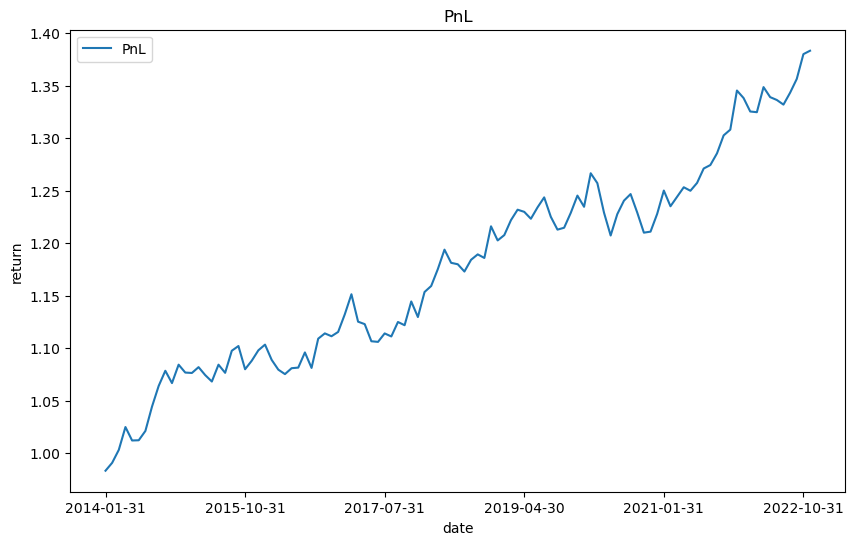

,ret,std,sharpe,universe
0,1.38328,0.011832,0.699583,129.570093


,ret,std,sharpe,universe
0,1.38328,0.011832,0.699583,129.570093


In [258]:
industry_alpha = BackTest(features_db_unemployed)
industry_alpha.create_alpha(industry_alpha.rank(industry_alpha.SMA('ratingSeniorLeadership_mean', 12)))
industry_alpha.run(display_plot=True)

# Frameworks

In [5]:
def backtest_featureonly(features_db, features, exec_alpha, universe=None):
    """
    Basically construct L/S Portfolio on a particular feature
    """
    columns = features
    periods = [1,3,6,12,24,36]  
    
    industry_alpha = BackTest(features_db, universe=universe)
    
    fig, axes = plt.subplots(nrows=len(columns), ncols=len(periods), figsize=(len(columns)*10,len(columns)*5))
    fig.suptitle('Alpha Calculation for Different Ratings and Periods')
    
    for i, column in enumerate(columns):
        for j, period in enumerate(periods):
            alpha = eval(exec_alpha)
            industry_alpha.create_alpha(alpha)
            _ = industry_alpha.run(display_plot=False)
            
            x_data, y_data = industry_alpha.plot_pnl(display_plot=False)
            
            ax = axes[j,i]
            ax.plot(x_data, y_data)
                    
            ax.set_title(f'{column} | Periods: {period}', fontsize=15)
            ax.set_xticks(range(0, len(x_data), max(1, len(x_data) // 3)))
            ax.set_xlabel('Time')
            ax.set_ylabel('PnL')
            ax.grid(True)
    
    
    plt.subplots_adjust(hspace=10, wspace=20) 
    plt.tight_layout(rect=[0, 0, 1, 0.96]) 
    plt.show()

In [80]:
def backtest_rank(features_db, features, exec_alpha, universe=None, start_date="2014-01-01", end_date="2022-12-30"):

    columns = features
    periods = [1,3,6,12,24,36]  
    
    industry_alpha = BackTest(features_db, universe=universe, start_date=start_date, end_date=end_date)
    
    all_res = []
    for i, column in enumerate(columns):
        for j, period in enumerate(periods):
            alpha = eval(exec_alpha)
            industry_alpha.create_alpha(alpha)
            _ = industry_alpha.run(display_plot=False)
            res = industry_alpha.get_metrics()
            
            dp = {
                'experiment': f"{column}_{period}M",
                'ret': res['ret'].values[0],
                'sharpe': res['sharpe'].values[0],
                'universe': res['universe'].values[0],
            }
            all_res.append(dp)
                
           
    return pd.DataFrame(all_res)

In [79]:
def backtest_rank_diff(features_db, features, exec_alpha, universe=None, start_date="2014-01-01", end_date="2022-12-30"):

    columns = features
    periods = [(12, 24), (6, 12), (3, 6)]  
    
    industry_alpha = BackTest(features_db, universe=universe, start_date=start_date, end_date=end_date)
    
    all_res = []
    for i, column in enumerate(columns):
        for j, (short_period, long_period) in enumerate(periods):
            alpha = eval(exec_alpha)
            industry_alpha.create_alpha(alpha)
            _ = industry_alpha.run(display_plot=False)
            res = industry_alpha.get_metrics()
            
            dp = {
                'experiment': f"{column}_{short_period}/{long_period}M",
                'ret': res['ret'].values[0],
                'sharpe': res['sharpe'].values[0],
                'universe': res['universe'].values[0],
            }
            all_res.append(dp)
                
           
    return pd.DataFrame(all_res)

In [81]:
def backtest_LSdiff(features_db, features, exec_alpha, universe=None, start_date="2014-01-01", end_date="2022-12-30"):
    """
    Rank of long term rating - short term rating (we long when current rating is worse than long term)
    eg. -industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - 
                                          industry_alpha.SMA(f'{column}', long_period))
    """
    
    columns = features
    periods = [(12, 24), (6, 12), (3, 6)]  
    
    industry_alpha = BackTest(features_db, universe=universe, start_date=start_date, end_date=end_date)
    
    fig, axes = plt.subplots(nrows=len(columns), ncols=len(periods), figsize=(len(columns)*8,len(columns)*5))
    fig.suptitle('Alpha Calculation for Different Ratings and Periods')
    
    for i, column in enumerate(columns):
        for j, (short_period, long_period) in enumerate(periods):
            alpha = eval(exec_alpha)
            industry_alpha.create_alpha(alpha)
            _ = industry_alpha.run(display_plot=False)
            
            x_data, y_data = industry_alpha.plot_pnl(display_plot=False)
            
            ax = axes[j,i]
            ax.plot(x_data, y_data)
                    
            ax.set_title(f'{column} | Periods: {short_period}-{long_period}', fontsize=20)
            ax.set_xticks(range(0, len(x_data), max(1, len(x_data) // 3)))
            ax.set_xlabel('Time')
            ax.set_ylabel('PnL')
            ax.grid(True)
    
    
    plt.subplots_adjust(hspace=10, wspace=20) 
    plt.tight_layout(rect=[0, 0, 1, 0.96]) 
    plt.show()

# Higher order relation

In [9]:
rolling_ratings = pd.read_csv('data/rolling_period_ratings_stats.csv')
filtered_df = rolling_ratings[(rolling_ratings['reviewDateTime']>'2014-01-01')] # & (rolling_ratings['reviewDateTime']<'2019-9-01')
universe = list(set(filters['more_than_50_reviews']) & set(filters['on_glassdoor_before_2013']) & set(filters['mcap>e9']))
filtered_df = filtered_df[filtered_df['ticker'].isin(universe)]
filtered_df = filtered_df.drop_duplicates()

# universe = list(set(universe) & set(features_db['ratingSeniorLeadership_mean'].columns.values))

In [ ]:
columns = ['ratingOverall_mean', 'ratingCompensationAndBenefits_mean', 'ratingSeniorLeadership_mean', 'ratingWorkLifeBalance_mean',
           'ratingCareerOpportunities_mean',  'ratingDiversityAndInclusion_mean']
backtest_LSdiff(features_db, columns, 
                "-industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))")

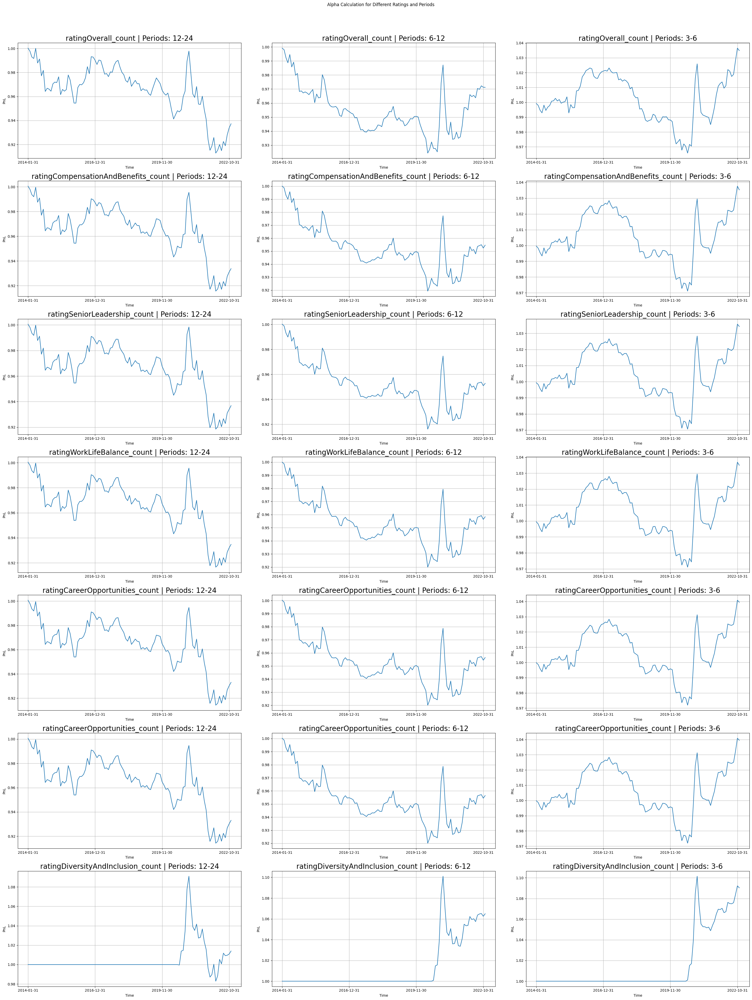

In [54]:
columns = ['ratingOverall_count', 'ratingCompensationAndBenefits_count', 'ratingSeniorLeadership_count', 'ratingWorkLifeBalance_count',
        'ratingCareerOpportunities_count', 'ratingCareerOpportunities_count',  'ratingDiversityAndInclusion_count']

backtest_LSdiff(features_db, columns, 
                "-industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))")

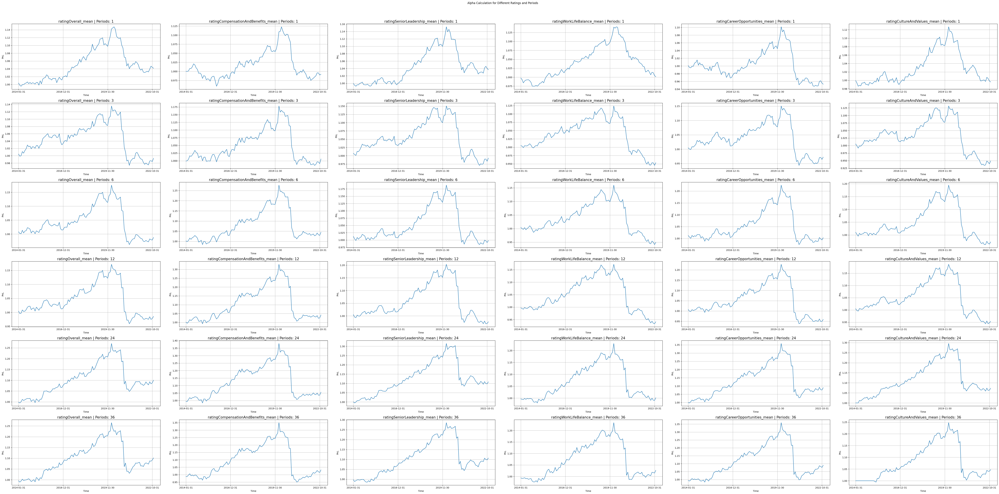

In [143]:
columns = ['ratingOverall_mean', 'ratingCompensationAndBenefits_mean', 'ratingSeniorLeadership_mean', 'ratingWorkLifeBalance_mean',
        'ratingCareerOpportunities_mean', 'ratingCultureAndValues_mean']
backtest_featureonly(features_db, columns, "industry_alpha.rank(industry_alpha.SMA(f'{column}', period))")

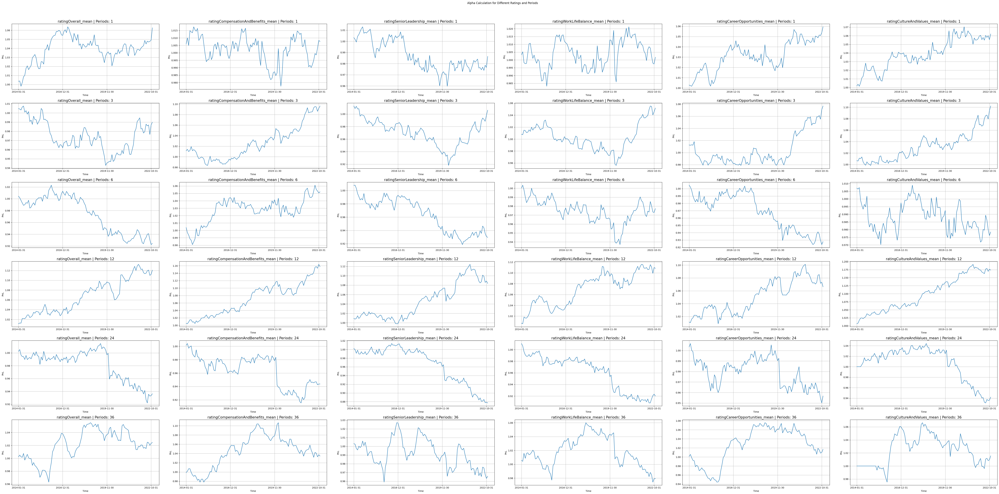

In [163]:
columns = ['ratingOverall_mean', 'ratingCompensationAndBenefits_mean', 'ratingSeniorLeadership_mean', 'ratingWorkLifeBalance_mean',
        'ratingCareerOpportunities_mean', 'ratingCultureAndValues_mean']
backtest_featureonly(features_db, columns, "-(industry_alpha.diff(f'{column}', period))")

# Only running on unemployed/employed reviews

In [35]:
features_db_unemployed = pd.read_pickle('data/DB@rating_numeric_unemployed.pkl')
features_db_employed = pd.read_pickle('data/DB@rating_numeric_employed.pkl')

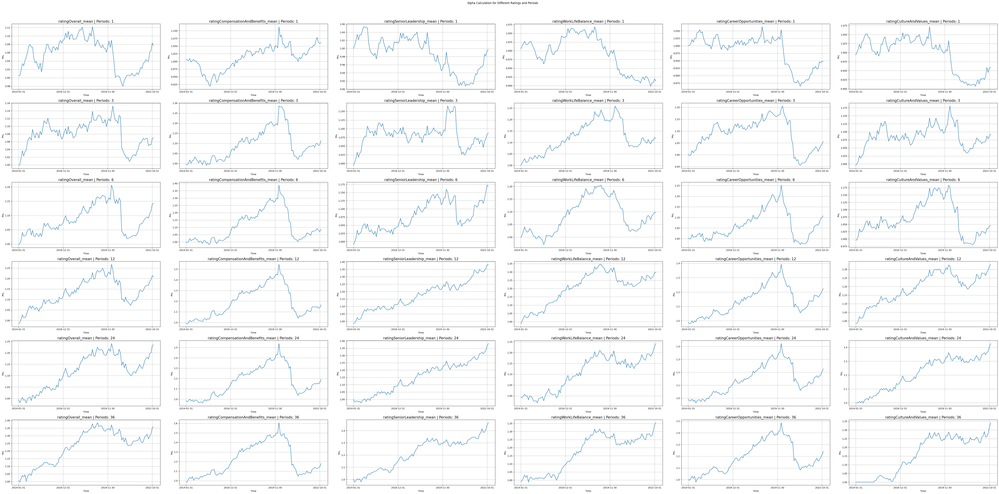

In [146]:
columns = ['ratingOverall_mean', 'ratingCompensationAndBenefits_mean', 'ratingSeniorLeadership_mean', 'ratingWorkLifeBalance_mean',
        'ratingCareerOpportunities_mean', 'ratingCultureAndValues_mean']
backtest_featureonly(features_db_unemployed, columns, "industry_alpha.rank(industry_alpha.SMA(f'{column}', period))")

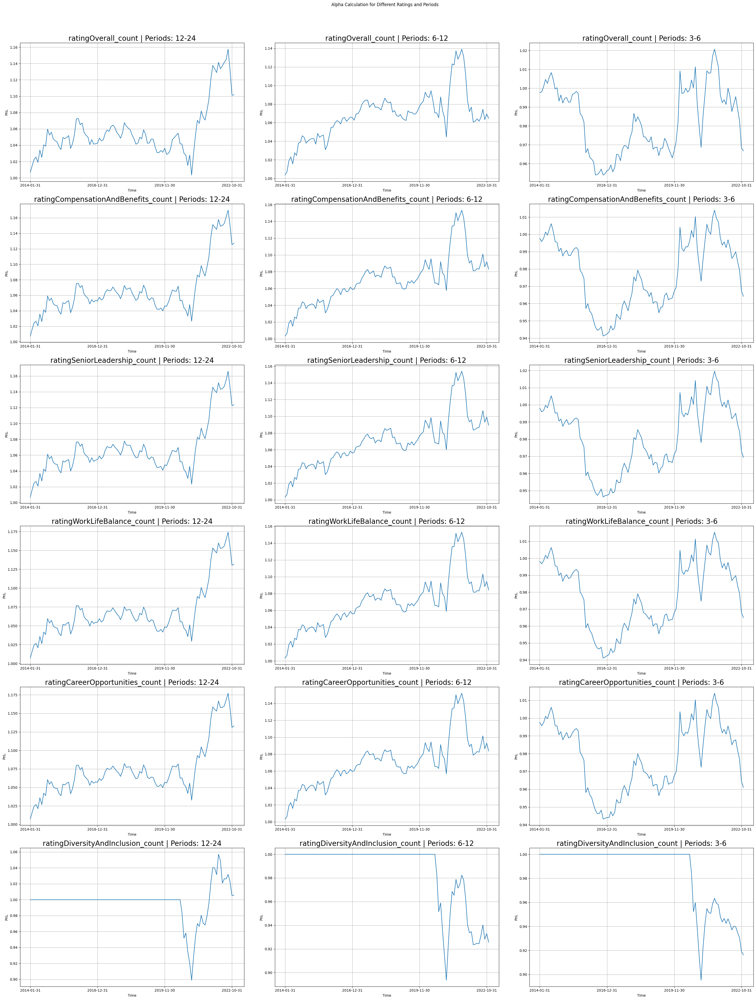

In [64]:
columns = ['ratingOverall_count', 'ratingCompensationAndBenefits_count', 'ratingSeniorLeadership_count', 'ratingWorkLifeBalance_count',
        'ratingCareerOpportunities_count', 'ratingDiversityAndInclusion_count']

backtest_LSdiff(features_db_unemployed, columns, 
                "industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))")

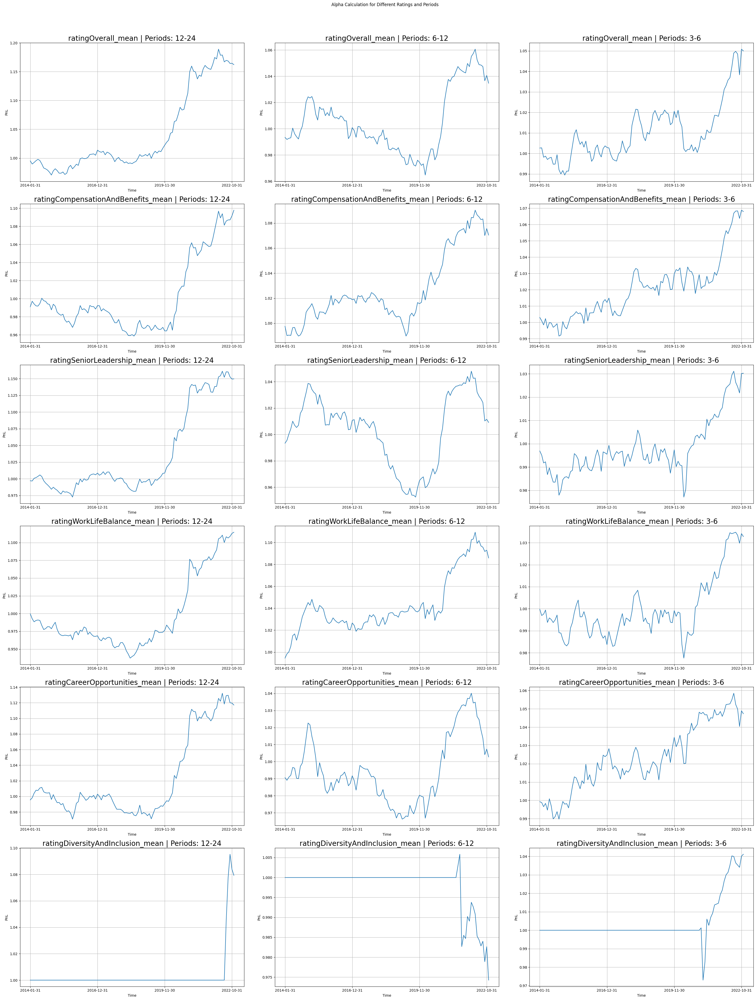

In [66]:
columns = ['ratingOverall_mean', 'ratingCompensationAndBenefits_mean', 'ratingSeniorLeadership_mean', 'ratingWorkLifeBalance_mean',
           'ratingCareerOpportunities_mean',  'ratingDiversityAndInclusion_mean']
backtest_LSdiff(features_db, columns, 
                "-industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))")

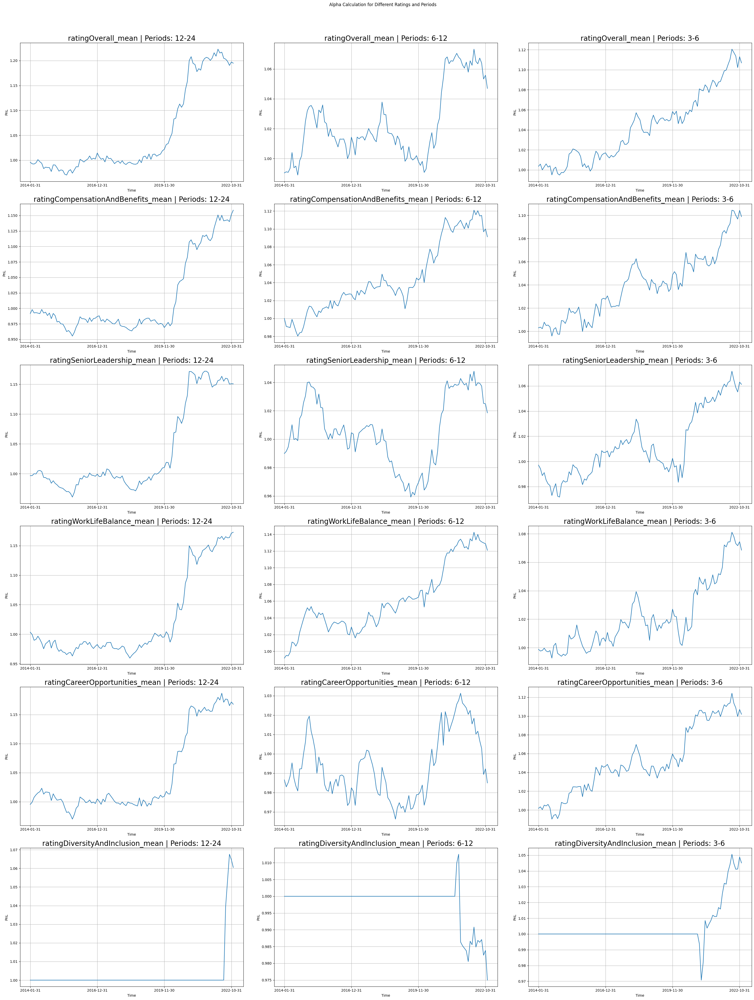

In [94]:
columns = ['ratingOverall_mean', 'ratingCompensationAndBenefits_mean', 'ratingSeniorLeadership_mean', 'ratingWorkLifeBalance_mean',
           'ratingCareerOpportunities_mean',  'ratingDiversityAndInclusion_mean']
backtest_LSdiff(features_db, columns, 
                "-np.log(industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period)))")

# NLP backtest

In [47]:
features_db_nlp = pd.read_pickle('data/DB@nlp_ratings.pkl')

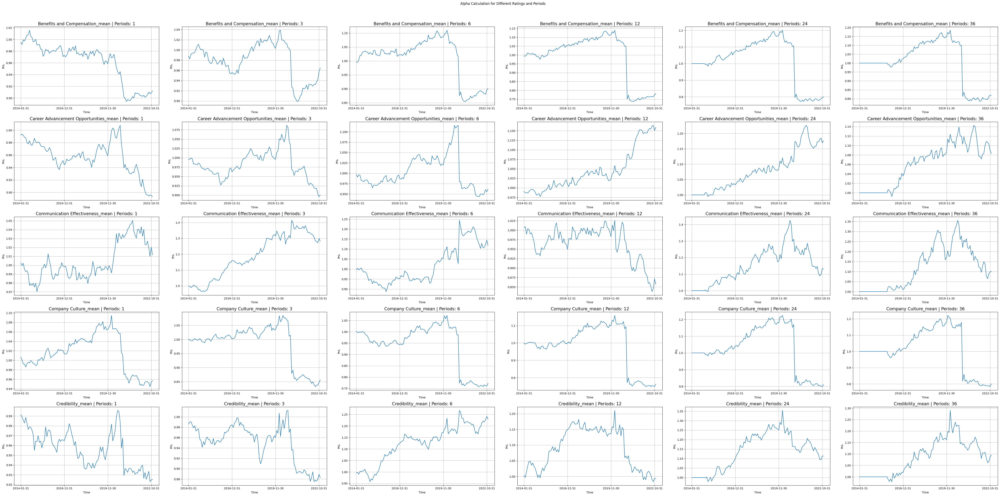

In [87]:
nlp_features = feature_db_nlp.columns.get_level_values(0).unique()
columns = []
for i in nlp_features:
    if i[-5:]=='_mean':
        columns.append(i)
columns = columns[:5]
backtest_featureonly(feature_db_nlp, columns,"industry_alpha.SMA(f'{column}', period)")

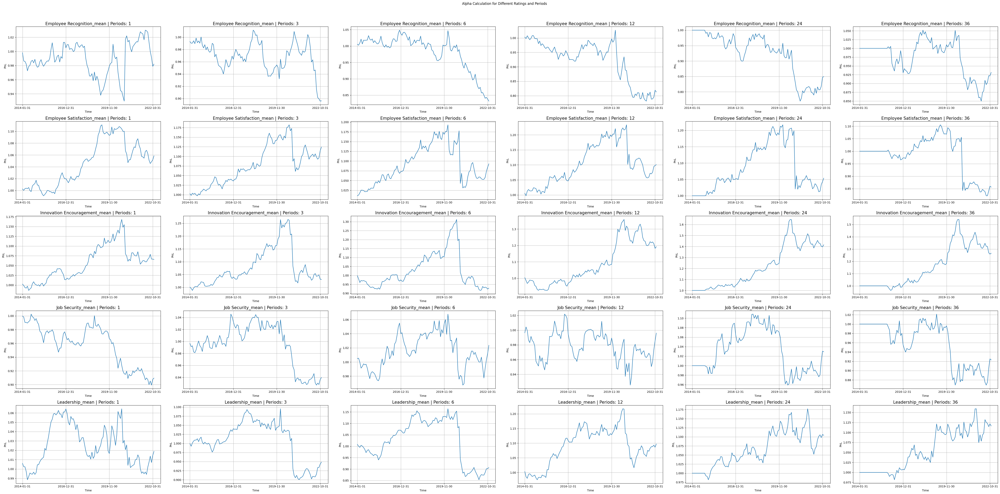

In [88]:
columns = []
for i in nlp_features:
    if i[-5:]=='_mean':
        columns.append(i)
columns = columns[5:10]
backtest_featureonly(feature_db_nlp, columns,"industry_alpha.SMA(f'{column}', period)")

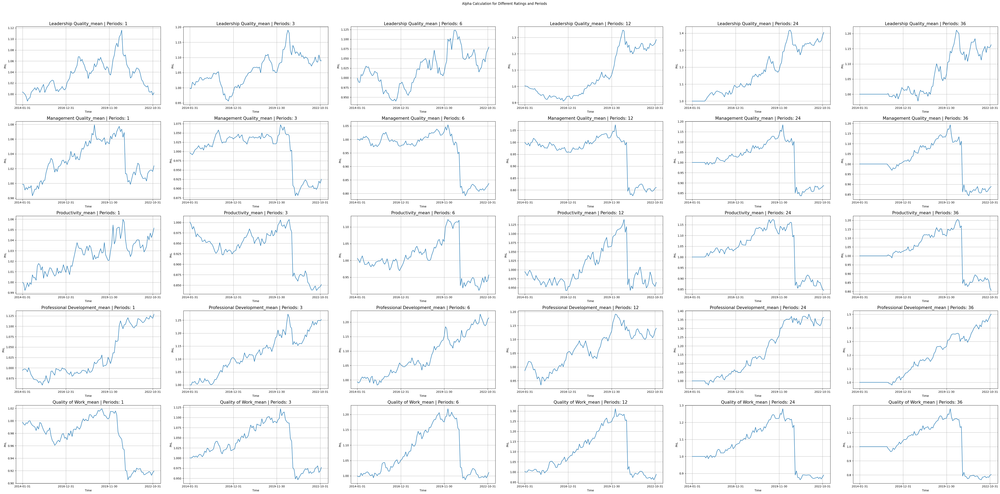

In [89]:
columns = []
for i in nlp_features:
    if i[-5:]=='_mean':
        columns.append(i)
columns = columns[10:15]
backtest_featureonly(feature_db_nlp, columns,"industry_alpha.SMA(f'{column}', period)")

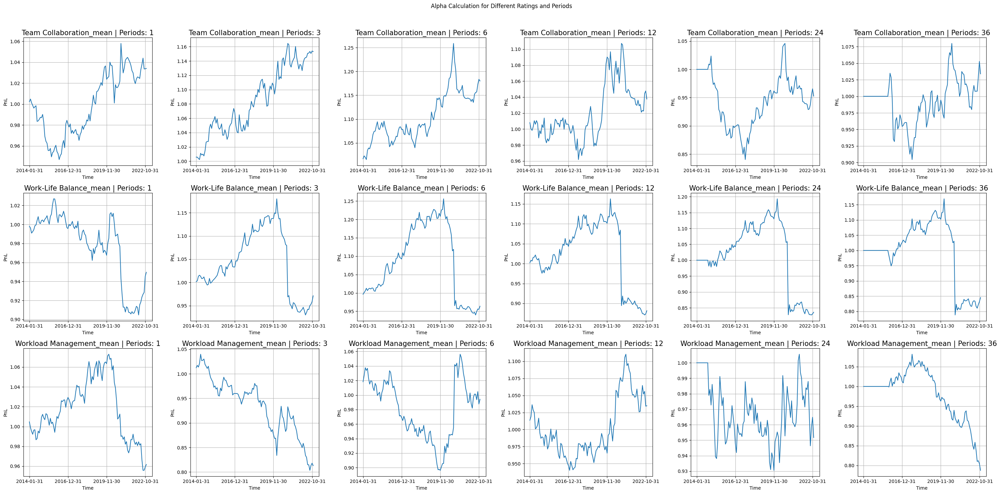

In [90]:
columns = []
for i in nlp_features:
    if i[-5:]=='_mean':
        columns.append(i)
columns = columns[15:]
backtest_featureonly(feature_db_nlp, columns,"industry_alpha.SMA(f'{column}', period)")

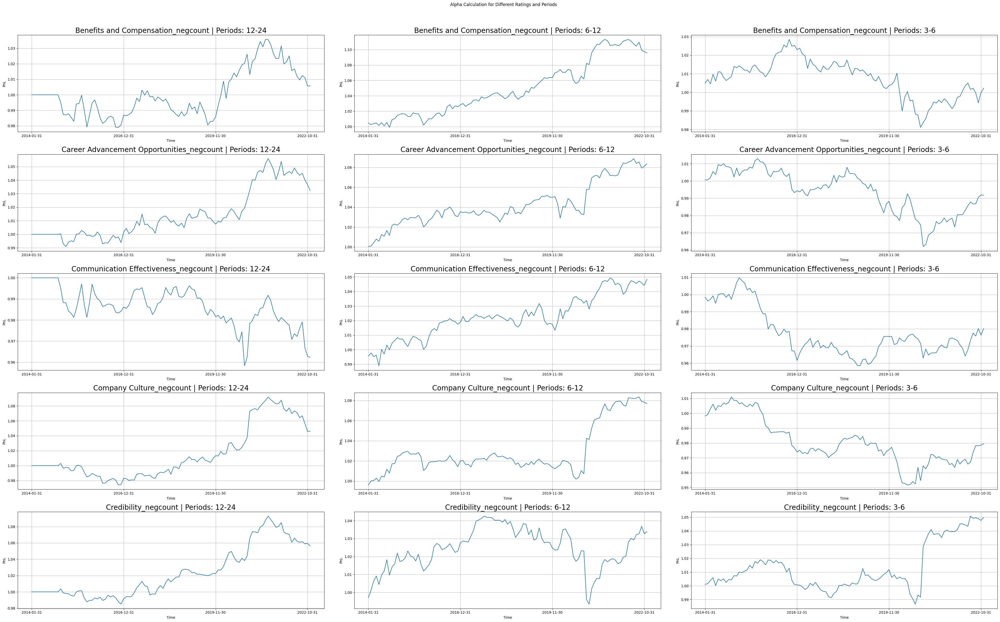

In [131]:
columns = []
for i in nlp_features:
    if i[-9:]=='_negcount':
        columns.append(i)
columns = columns[:5]

backtest_LSdiff(feature_db_nlp, columns, 
                "industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))")

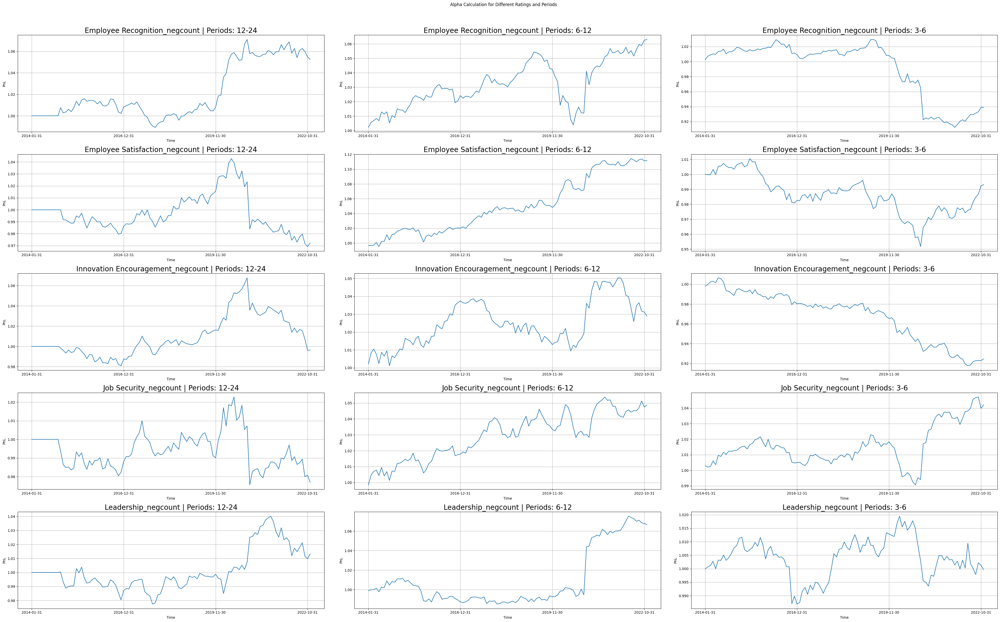

In [132]:
columns = []
for i in nlp_features:
    if i[-9:]=='_negcount':
        columns.append(i)
columns = columns[5:10]

backtest_LSdiff(feature_db_nlp, columns, 
                "industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))")

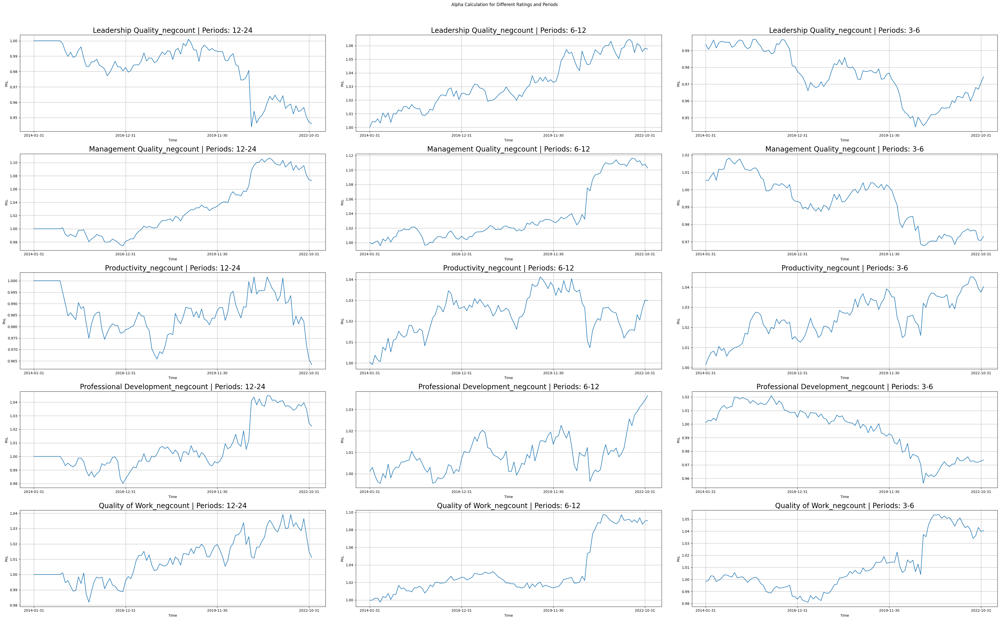

In [133]:
columns = []
for i in nlp_features:
    if i[-9:]=='_negcount':
        columns.append(i)
columns = columns[10:15]

backtest_LSdiff(feature_db_nlp, columns, 
                "industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))")

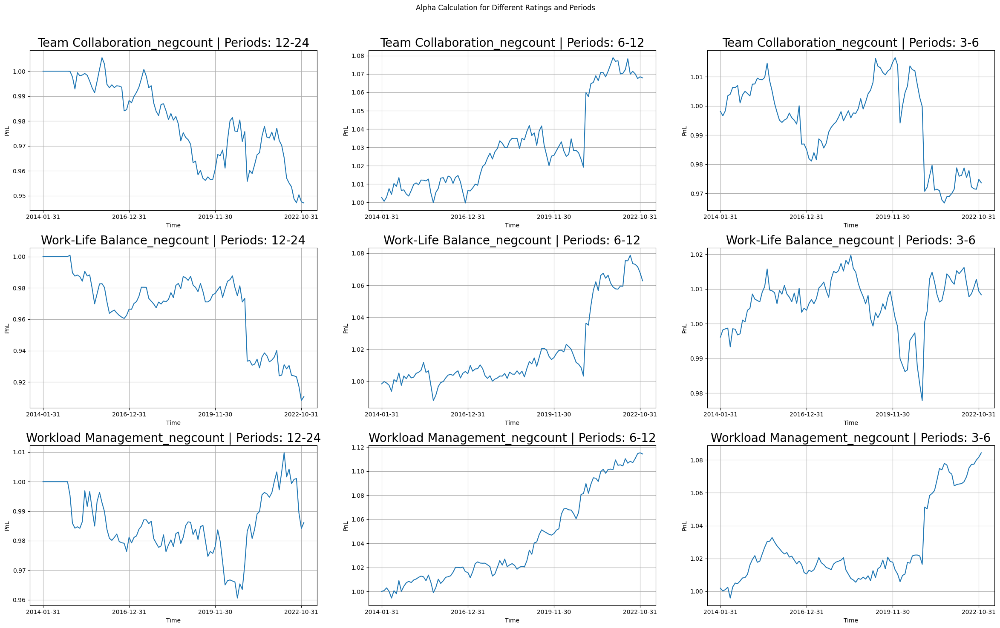

In [134]:
columns = []
for i in nlp_features:
    if i[-9:]=='_negcount':
        columns.append(i)
columns = columns[15:20]

backtest_LSdiff(feature_db_nlp, columns, 
                "industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))")

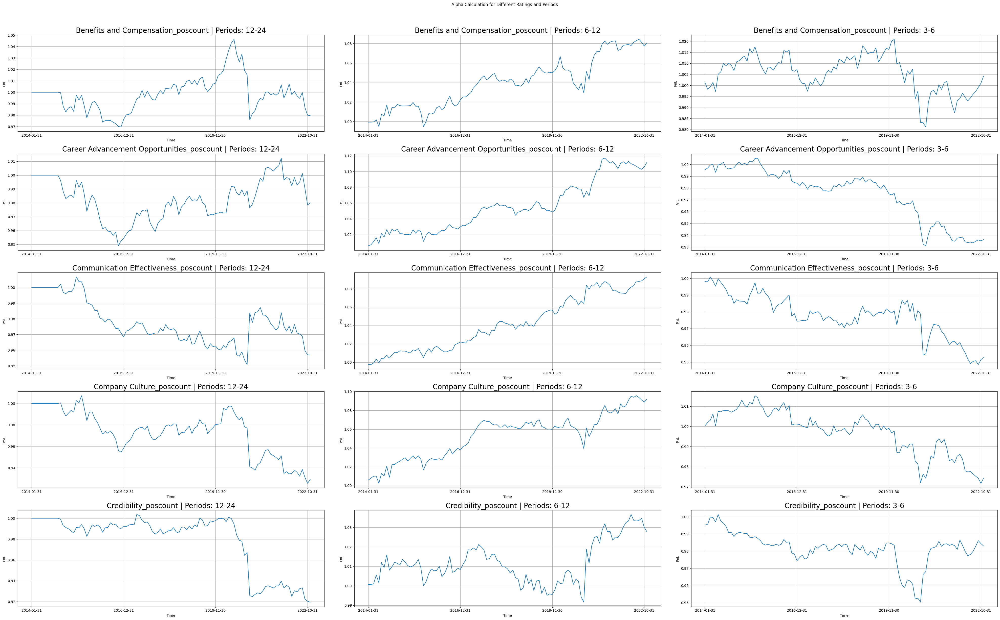

In [138]:
columns = []
for i in nlp_features:
    if i[-9:]=='_poscount':
        columns.append(i)
columns = columns[:5]

backtest_LSdiff(feature_db_nlp, columns, 
                "industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))")

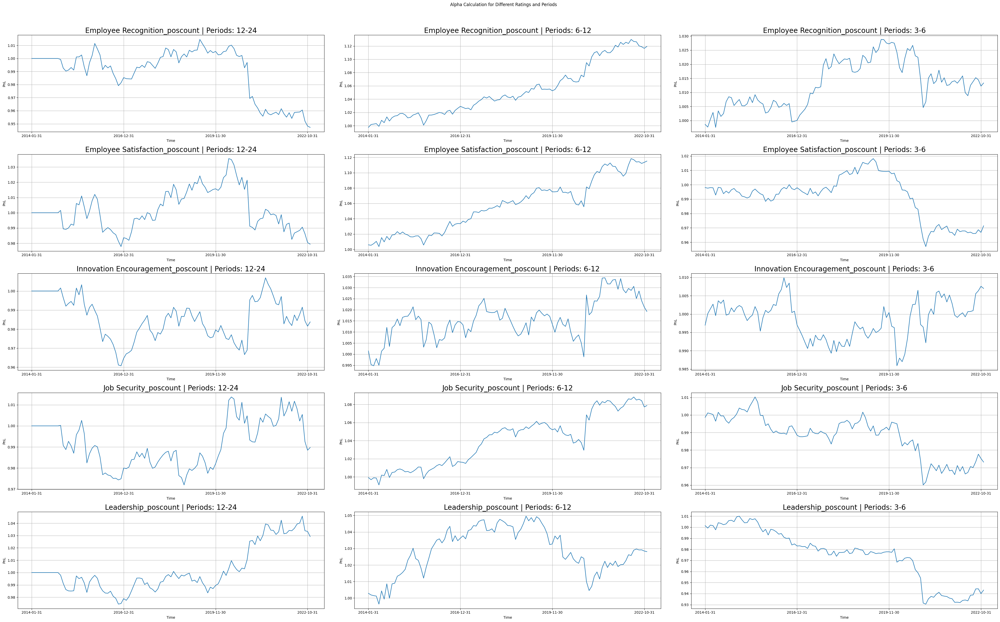

In [137]:
columns = []
for i in nlp_features:
    if i[-9:]=='_poscount':
        columns.append(i)
columns = columns[5:10]

backtest_LSdiff(feature_db_nlp, columns, 
                "industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))")

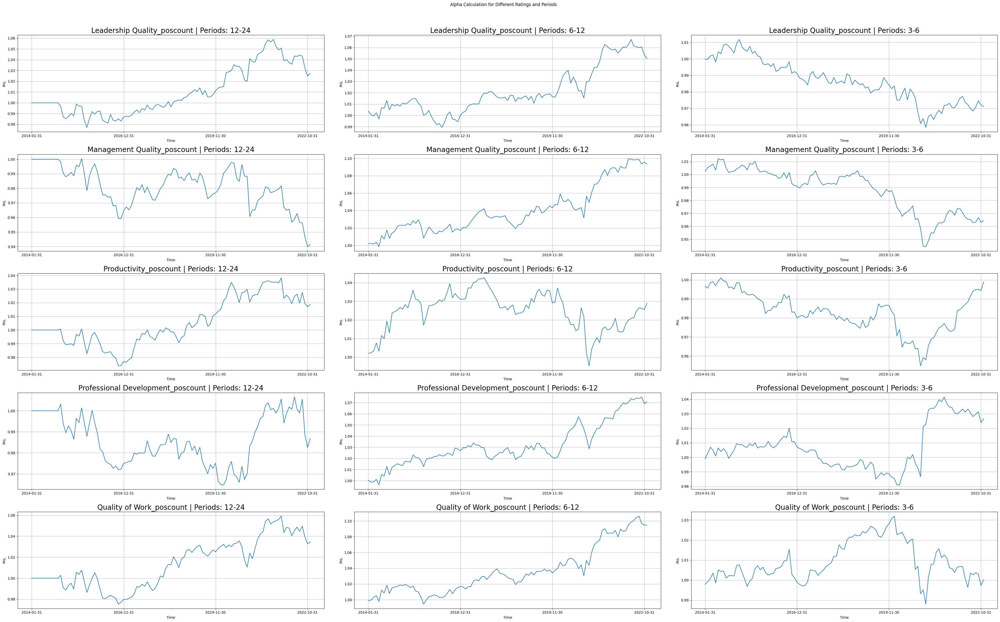

In [136]:
columns = []
for i in nlp_features:
    if i[-9:]=='_poscount':
        columns.append(i)
columns = columns[10:15]

backtest_LSdiff(feature_db_nlp, columns, 
                "industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))")

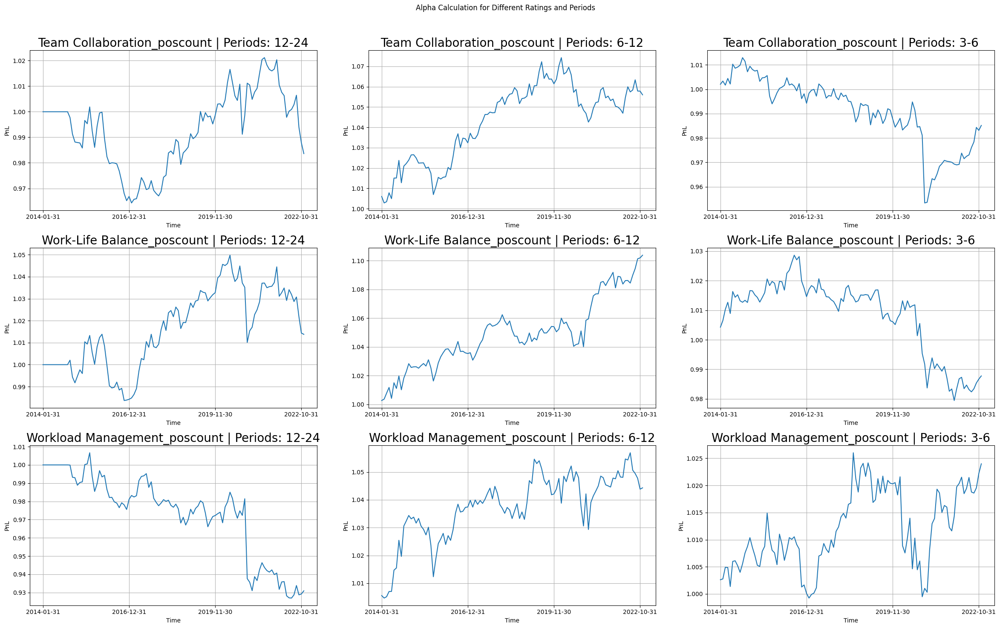

In [135]:
columns = []
for i in nlp_features:
    if i[-9:]=='_poscount':
        columns.append(i)
columns = columns[15:20]

backtest_LSdiff(feature_db_nlp, columns, 
                "industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))")

# Ranking

In [9]:
numeric = ['ratingOverall_mean', 'ratingCompensationAndBenefits_mean', 'ratingSeniorLeadership_mean', 'ratingWorkLifeBalance_mean',
           'ratingCareerOpportunities_mean',  'ratingCultureAndValues_mean']

In [10]:
nlp_features = features_db_nlp.columns.get_level_values(0).unique()
nlp = []
nlp_negcount = []
nlp_poscount = []

for i in nlp_features:
    if i[-5:]=='_mean':
        nlp.append(i)
    elif i[-9:]=='_negcount':
        nlp_negcount.append(i)
    elif i[-9:]=='_poscount':
        nlp_poscount.append(i)

In [74]:
def create_backtest_series_wfilter(universe, start_date='2014-01-01', end_date='2022-12-30'):
    BACKTEST = {}
    BACKTEST['backtest_SMA'] = backtest_rank(features_db, numeric, 
                                 "industry_alpha.rank(industry_alpha.SMA(f'{column}', period))", 
                                             start_date=start_date, end_date=end_date,universe=universe)
    BACKTEST['backtest_SMA_unemployed'] = backtest_rank(features_db_unemployed, numeric, 
                                            "industry_alpha.rank(industry_alpha.SMA(f'{column}', period))", 
                                                        start_date=start_date, end_date=end_date, universe=universe)
    BACKTEST['backtest_SMA_nlp'] = backtest_rank(features_db_nlp, nlp, 
                                            "industry_alpha.rank(industry_alpha.SMA(f'{column}', period))", 
                                                 start_date=start_date, end_date=end_date, universe=universe)
    
    BACKTEST['backtest_diff'] = backtest_rank(features_db, numeric, 
                                            "-(industry_alpha.diff(f'{column}', period))", 
                                              start_date=start_date, end_date=end_date, universe=universe)
    BACKTEST['backtest_diff_unemployed'] = backtest_rank(features_db_unemployed, numeric, 
                                            "-(industry_alpha.diff(f'{column}', period))", 
                                                         start_date=start_date, end_date=end_date, universe=universe)
    
    BACKTEST['backtest_SMAdiff_nlp_poscount'] = backtest_rank_diff(features_db_nlp, nlp_poscount,
            "industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))", 
                                                                   start_date=start_date, end_date=end_date, universe=universe)
    
    BACKTEST['backtest_SMAdiff_nlp_negcount'] = backtest_rank_diff(features_db_nlp, nlp_negcount,
            "industry_alpha.rank(industry_alpha.SMA(f'{column}', short_period) - industry_alpha.SMA(f'{column}', long_period))", 
                                                                   start_date=start_date, end_date=end_date, universe=universe)

    return BACKTEST

In [12]:
nofilters = pd.DataFrame()
for strat, df in create_backtest_series_wfilter(None).items():
    df['strat'] = [strat]*len(df)
    nofilters=pd.concat([nofilters, df])
nofilters = nofilters.reset_index(drop=True).sort_values('sharpe',ascending=False)

In [269]:
nofilters[nofilters['strat'].isin(['backtest_SMAdiff_nlp_poscount', 'backtest_SMAdiff_nlp_negcount'])].head()

,experiment,ret,sharpe,universe,strat
268,Employee Recognition_poscount_6/12M,1.119334,0.268329,978.757009,backtest_SMAdiff_nlp_poscount
358,Workload Management_negcount_6/12M,1.114254,0.251849,978.757009,backtest_SMAdiff_nlp_negcount
271,Employee Satisfaction_poscount_6/12M,1.115222,0.229193,978.757009,backtest_SMAdiff_nlp_poscount
325,Employee Satisfaction_negcount_6/12M,1.111572,0.221497,978.757009,backtest_SMAdiff_nlp_negcount
256,Career Advancement Opportunities_poscount_6/12M,1.111522,0.216098,978.757009,backtest_SMAdiff_nlp_poscount


In [268]:
nofilters.tail()

,experiment,ret,sharpe,universe,strat
272,Employee Satisfaction_poscount_3/6M,0.971422,-1.080540,992.700935,backtest_SMAdiff_nlp_poscount
341,Management Quality_negcount_3/6M,0.973150,-1.088215,992.700935,backtest_SMAdiff_nlp_negcount
281,Leadership_poscount_3/6M,0.943200,-1.163268,992.700935,backtest_SMAdiff_nlp_poscount
257,Career Advancement Opportunities_poscount_3/6M,0.936267,-1.257584,992.700935,backtest_SMAdiff_nlp_poscount
329,Innovation Encouragement_negcount_3/6M,0.924689,-1.523354,992.700935,backtest_SMAdiff_nlp_negcount


In [82]:
nofilters_1420 = pd.DataFrame()
for strat, df in create_backtest_series_wfilter(None, end_date='2019-12-30').items():
    df['strat'] = [strat]*len(df)
    nofilters_1420=pd.concat([nofilters_1420, df])
nofilters_1420 = nofilters_1420.reset_index(drop=True).sort_values('sharpe',ascending=False)

In [87]:
nofilters_1420[nofilters_1420['strat'].isin(['backtest_SMA_nlp','backtest_SMAdiff_nlp_poscount', 'backtest_SMAdiff_nlp_negcount'])].head()

,experiment,ret,sharpe,universe,strat
85,Communication Effectiveness_mean_3M,1.309633,1.208636,165.915493,backtest_SMA_nlp
154,Professional Development_mean_24M,1.258443,0.830507,67.050000,backtest_SMA_nlp
159,Quality of Work_mean_12M,1.213132,0.733744,301.619718,backtest_SMA_nlp
170,Work-Life Balance_mean_6M,1.189576,0.713973,283.183099,backtest_SMA_nlp
100,Credibility_mean_24M,1.237056,0.674487,63.566667,backtest_SMA_nlp


In [267]:
nofilters_1420.tail()

,experiment,ret,sharpe,universe,strat
281,Leadership_poscount_3/6M,0.977771,-1.348729,971.845070,backtest_SMAdiff_nlp_poscount
351,Team Collaboration_negcount_12/24M,0.960639,-1.385927,932.783333,backtest_SMAdiff_nlp_negcount
317,Company Culture_negcount_3/6M,0.975508,-1.419446,971.845070,backtest_SMAdiff_nlp_negcount
329,Innovation Encouragement_negcount_3/6M,0.965468,-1.463519,971.845070,backtest_SMAdiff_nlp_negcount
258,Communication Effectiveness_poscount_12/24M,0.962584,-1.546624,932.783333,backtest_SMAdiff_nlp_poscount


In [44]:
universe=set(filters['more_than_109_review_per_quarter'])

filter_review = pd.DataFrame()
for strat, df in create_backtest_series_wfilter(universe).items():
    df['strat'] = [strat]*len(df)
    filter_review=pd.concat([filter_review, df])

In [170]:
filter_review.reset_index(drop=True).sort_values('sharpe',ascending=False).head()

,experiment,ret,sharpe,universe,strat
307,Benefits and Compensation_negcount_6/12M,1.375773,0.642205,109.850467,backtest_SMAdiff_nlp_negcount
152,Professional Development_mean_6M,1.271247,0.585621,88.224299,backtest_SMA_nlp
155,Professional Development_mean_36M,1.314801,0.550389,49.642857,backtest_SMA_nlp
85,Communication Effectiveness_mean_3M,1.638757,0.492526,87.738318,backtest_SMA_nlp
118,Innovation Encouragement_mean_24M,1.368546,0.481116,74.041667,backtest_SMA_nlp


In [185]:
universe=set(filters['mcap>e10'])

filter_mcap = pd.DataFrame()
for strat, df in create_backtest_series_wfilter(universe, end_date='2022-12-30').items():
    df['strat'] = [strat]*len(df)
    filter_mcap=pd.concat([filter_mcap, df])

filter_mcap = filter_mcap.reset_index(drop=True).sort_values('sharpe',ascending=False)

In [210]:
filter_mcap.head()

,experiment,ret,sharpe,universe,strat
150,Professional Development_mean_1M,1.236728,0.630561,268.084112,backtest_SMA_nlp
151,Professional Development_mean_3M,1.273856,0.627330,150.280374,backtest_SMA_nlp
152,Professional Development_mean_6M,1.273562,0.605466,100.429907,backtest_SMA_nlp
115,Innovation Encouragement_mean_3M,1.254608,0.497012,196.205607,backtest_SMA_nlp
118,Innovation Encouragement_mean_24M,1.345474,0.480359,77.010417,backtest_SMA_nlp


In [209]:
filter_mcap.tail()

,experiment,ret,sharpe,universe,strat
297,Team Collaboration_poscount_12/24M,0.904197,-1.037835,331.333333,backtest_SMAdiff_nlp_poscount
97,Credibility_mean_3M,0.827656,-1.040210,162.224299,backtest_SMA_nlp
329,Innovation Encouragement_negcount_3/6M,0.923328,-1.245924,335.457944,backtest_SMAdiff_nlp_negcount
257,Career Advancement Opportunities_poscount_3/6M,0.942673,-1.258608,335.457944,backtest_SMAdiff_nlp_poscount
258,Communication Effectiveness_poscount_12/24M,0.906866,-1.282881,331.333333,backtest_SMAdiff_nlp_poscount


In [211]:
universe=set(filters['more_than_10_review_per_month'])

filter_review_monthly = pd.DataFrame()
for strat, df in create_backtest_series_wfilter(universe, end_date='2022-12-30').items():
    df['strat'] = [strat]*len(df)
    filter_review_monthly=pd.concat([filter_review_monthly, df])

filter_review_monthly = filter_review_monthly.reset_index(drop=True).sort_values('sharpe',ascending=False)

In [212]:
filter_review_monthly.head()

,experiment,ret,sharpe,universe,strat
155,Professional Development_mean_36M,1.400613,0.722620,52.023810,backtest_SMA_nlp
154,Professional Development_mean_24M,1.365208,0.656982,62.781250,backtest_SMA_nlp
339,Management Quality_negcount_12/24M,1.265558,0.605758,299.760417,backtest_SMAdiff_nlp_negcount
85,Communication Effectiveness_mean_3M,1.445765,0.581247,151.028037,backtest_SMA_nlp
51,ratingSeniorLeadership_mean_12M,1.317083,0.576270,96.915888,backtest_SMA_unemployed


In [213]:
filter_review_monthly.tail()

,experiment,ret,sharpe,universe,strat
290,Productivity_poscount_3/6M,0.927303,-0.945096,303.598131,backtest_SMAdiff_nlp_poscount
217,ratingOverall_mean_3M,0.888755,-0.948126,110.934579,backtest_diff_unemployed
179,Workload Management_mean_36M,0.772063,-0.978245,44.333333,backtest_SMA_nlp
314,Communication Effectiveness_negcount_3/6M,0.926982,-1.059197,303.598131,backtest_SMAdiff_nlp_negcount
329,Innovation Encouragement_negcount_3/6M,0.832002,-1.997874,303.598131,backtest_SMAdiff_nlp_negcount


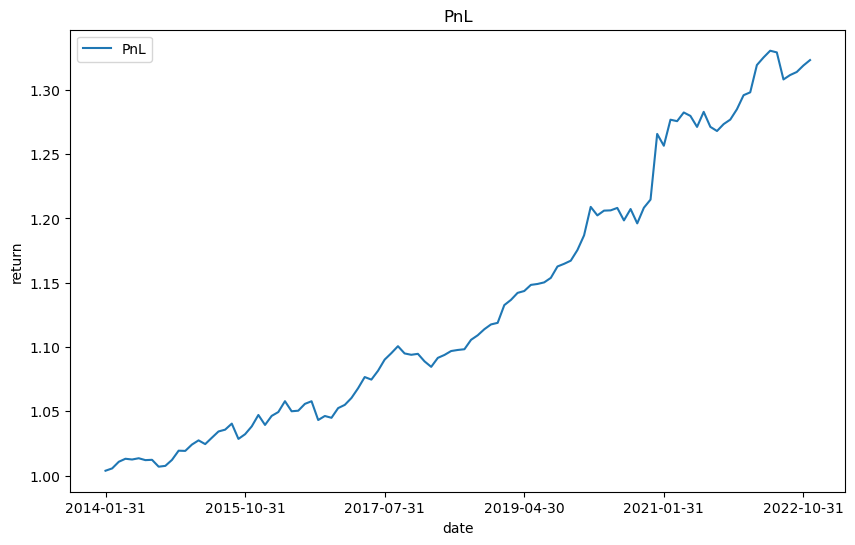

,ret,std,sharpe,universe
0,1.323128,0.006873,0.971164,109.850467


,ret,std,sharpe,universe
0,1.323128,0.006873,0.971164,109.850467


In [300]:
column = "Benefits and Compensation_negcount"
universe=set(filters['more_than_109_review_per_quarter'])
BCnegcount_alpha = BackTest(features_db_nlp, universe=universe, end_date='2022-12-30', decay=6)

BCnegcount_alpha.create_alpha(industry_alpha.rank(industry_alpha.SMA(f'{column}', 6) - industry_alpha.SMA(f'{column}', 12)))
BCnegcount_alpha.run(display_plot=True)

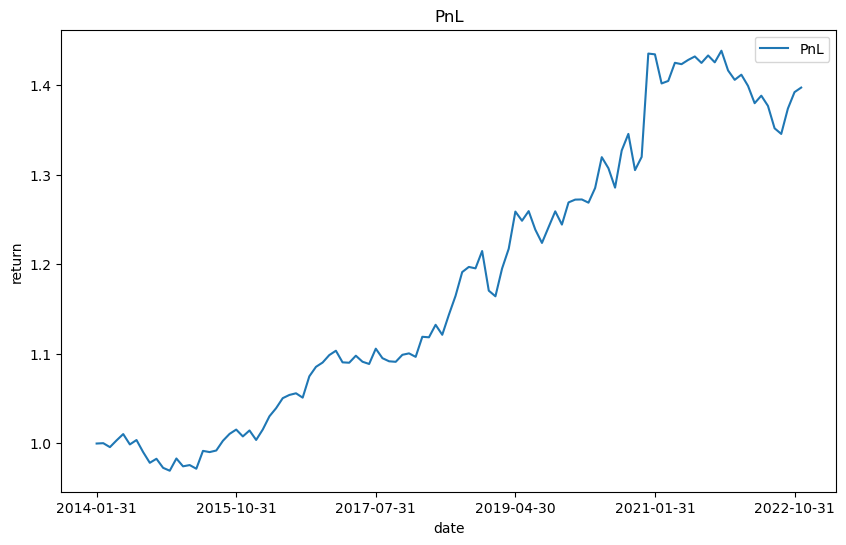

,ret,std,sharpe,universe
0,1.397325,0.01497,0.584057,253.457944


,ret,std,sharpe,universe
0,1.397325,0.01497,0.584057,253.457944


In [302]:
column = "Communication Effectiveness_mean"
universe=None
CE_alpha = BackTest(features_db_nlp, universe=universe, end_date="2022-12-30", decay=8)

CE_alpha.create_alpha(industry_alpha.rank(industry_alpha.SMA(f'{column}', 3)))
CE_alpha.run(display_plot=True)

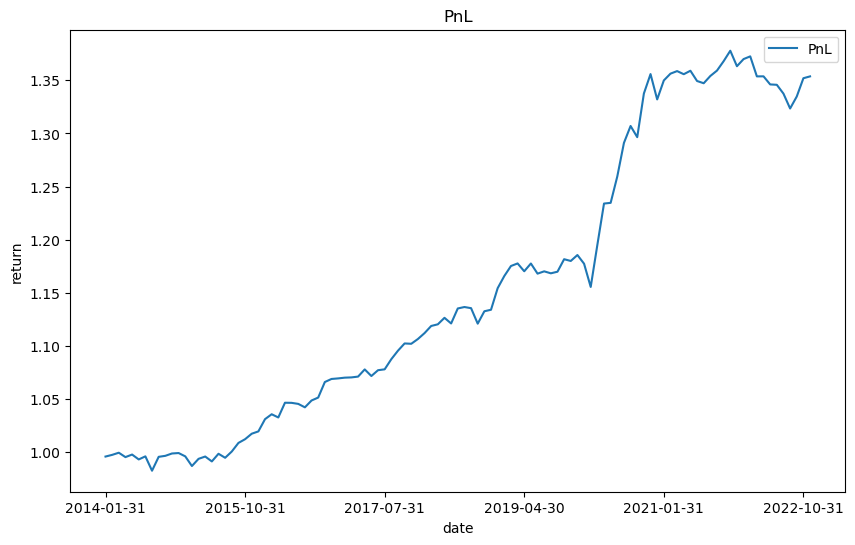

,ret,std,sharpe,universe
0,1.353731,0.009033,0.827552,728.906542


,ret,std,sharpe,universe
0,1.353731,0.009033,0.827552,728.906542


In [303]:
column = "Professional Development_mean"
universe=None
PD_alpha = BackTest(features_db_nlp, universe=universe, end_date="2022-12-30", decay=6)

PD_alpha.create_alpha(industry_alpha.rank(industry_alpha.SMA(f'{column}', 1)))
PD_alpha.run(display_plot=True)

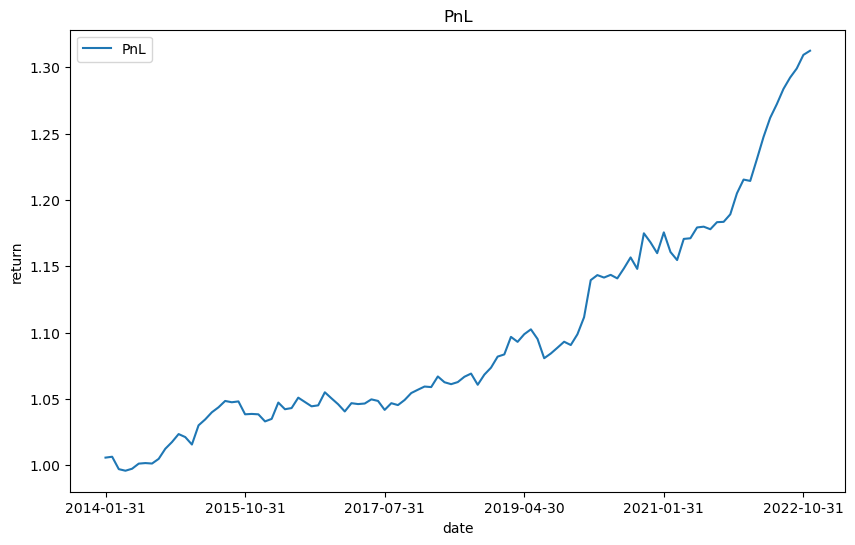

,ret,std,sharpe,universe
0,1.31249,0.006618,0.968178,303.598131


,ret,std,sharpe,universe
0,1.31249,0.006618,0.968178,303.598131


In [304]:
column = "Innovation Encouragement_negcount"
universe=set(filters['more_than_10_review_per_month'])
IE_negcount_alpha = BackTest(features_db_nlp, universe=universe, end_date='2022-12-30', decay=0)
IE_negcount_alpha.create_alpha(-(industry_alpha.SMA(f'{column}', 3) - industry_alpha.SMA(f'{column}', 6)))
IE_negcount_alpha.run(display_plot=True)

In [339]:
strats = pd.DataFrame()
strats['Communication Effectiveness'] = CE_alpha.portfolio_returns
strats['Innovation Encouragement'] = IE_negcount_alpha.portfolio_returns
strats['Benefits and Compensations'] = BCnegcount_alpha.portfolio_returns
strats['Professional Development'] = PD_alpha.portfolio_returns

In [341]:
strats.corr()

,Communication Effectiveness,Innovation Encouragement,Benefits and Compensations,Professional Development
Communication Effectiveness,1.000000,-0.133174,0.287962,-0.181077
Innovation Encouragement,-0.133174,1.000000,0.037035,0.032352
Benefits and Compensations,0.287962,0.037035,1.000000,-0.226265
Professional Development,-0.181077,0.032352,-0.226265,1.000000


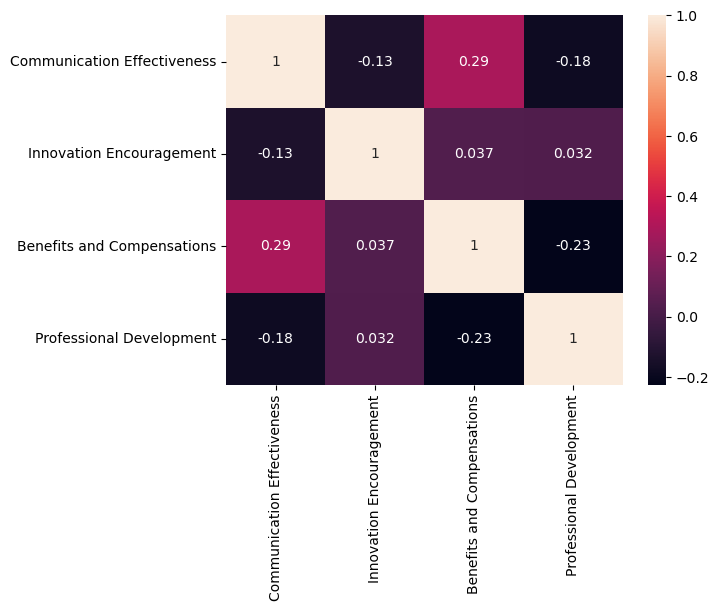

In [340]:
cm = strats.corr()
sns.heatmap(cm, annot=True)
plt.show()